In [1]:
#import relevant libraries 
import pandas as pd
import plotly.express as px
import panel as pn
import hvplot.pandas
import requests
import json
import numpy as np
import matplotlib.pyplot as plt
import json
from pathlib import Path
import alpaca_trade_api as tradeapi
from dotenv import load_dotenv
import os
from datetime import datetime, timedelta,date
from pandas import DataFrame


Pull in External Functions and Classes

In [2]:
from ticker_data import *
from EMA import *
from BOLLINGER import *
from MACD import *

Get the Stock Ticker Data

In [3]:
#from ticker_data.py run function get_ticker_data
stock_data_df=get_ticker_data(api,'SPY')

EMA Simulation and Optimal Calculations

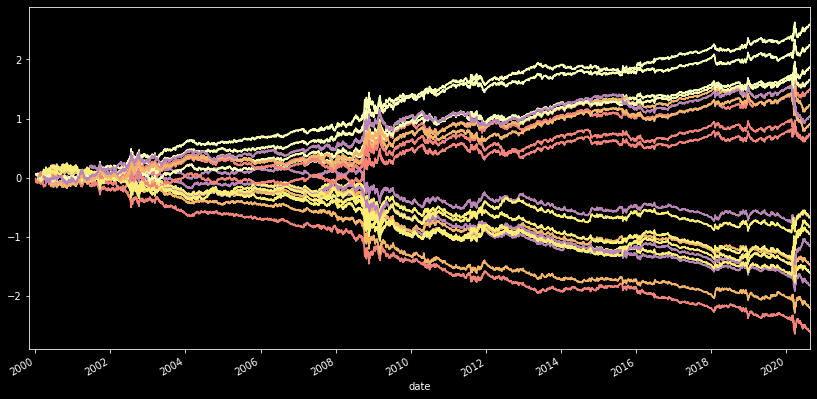

In [4]:
#from EMA.py run EMA_Optimal Calculator
ema_result=EMA_Optimal(stock_data_df)
opt_ema_df=ema_result.head()

In [5]:
#define the optimal outputs as variables
period=opt_ema_df['period'].iloc[0]
long_window=opt_ema_df['long_window'].iloc[0]
short_window=opt_ema_df['short_window'].iloc[0]

('48H', 32.0, 10.0, 2.5883887554337095, date
 1999-11-02    NaN
 1999-11-03    NaN
 1999-11-04    NaN
 1999-11-05    NaN
 1999-11-08    NaN
              ... 
 2020-08-13    1.0
 2020-08-14    1.0
 2020-08-17    1.0
 2020-08-18    1.0
 2020-08-19    1.0
 Name: EMA Signal, Length: 5233, dtype: float64)

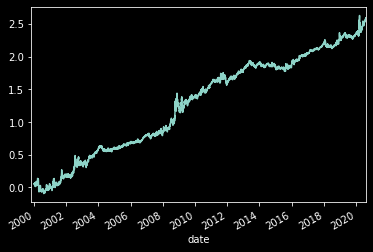

In [6]:
#from EMA.py run the EMA simulator on the optimal variables
EMAsimulator = EMASimulator(
    stock_data_df, 
    #from_date="2018-01-01", 
    period=period, 
    long_window=long_window, 
    short_window=short_window
)
EMAsimulator.simulate()

Bollinger Band Simulation and Optimal Calculations

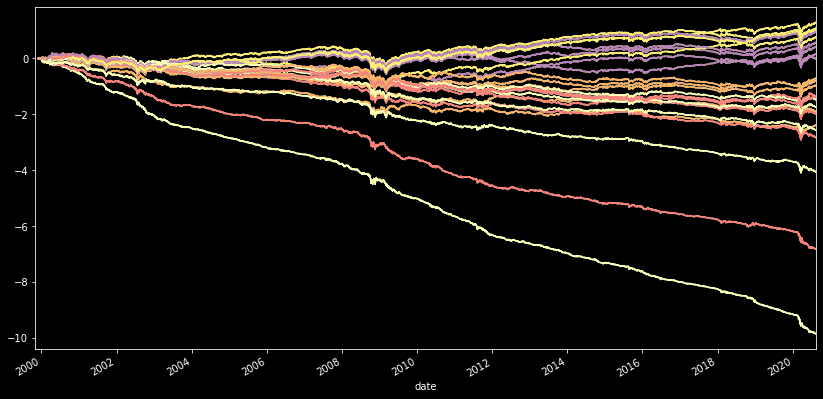

In [7]:
#from BOLLINGER.py run Bollinger_Band_Optimal Calculator
bollinger_result=Bollinger_Band_Optimal(stock_data_df)
opt_bollinger_df=bollinger_result.head()

In [8]:
#define the optimal outputs as variables
period=opt_bollinger_df['period'].iloc[0]
bollinger_window=int(opt_bollinger_df['bollinger_window'].iloc[0])
no_of_std=opt_bollinger_df['no_of_std'].iloc[0]

('12H', 77, 3.0, 1.2855848900053823, date
 1999-11-02    NaN
 1999-11-03    NaN
 1999-11-04    NaN
 1999-11-05    NaN
 1999-11-08    NaN
              ... 
 2020-08-13    1.0
 2020-08-14    1.0
 2020-08-17    1.0
 2020-08-18    1.0
 2020-08-19    1.0
 Name: Bollinger Signal, Length: 5233, dtype: float64)

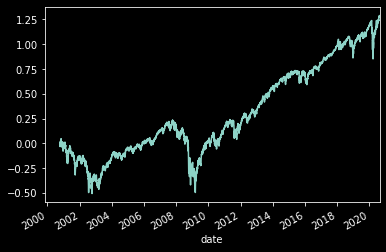

In [9]:
#from BOLLINGER.py run the BOLLINGER simulator on the optimal variables
BOLLINGERsimulator = BollingerBandsSimulator(
    stock_data_df, 
    #from_date="2018-01-01", 
    period=period, 
    bollinger_window=bollinger_window, 
    no_of_std=no_of_std
)
BOLLINGERsimulator.simulate()

MACD Simulation and Optimal Calculations

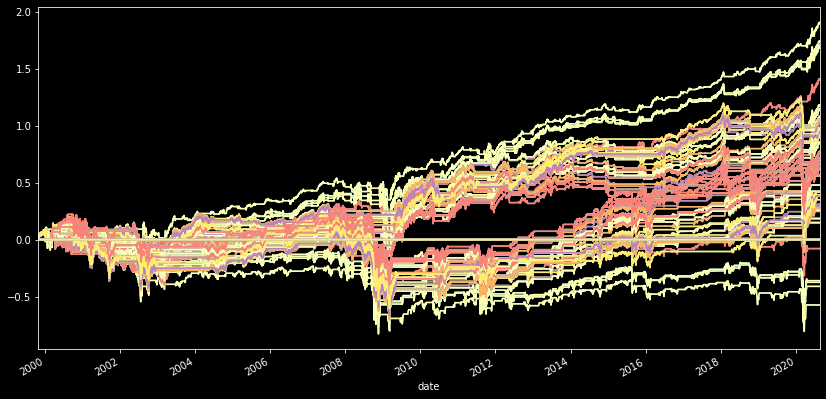

In [10]:
#from BOLLINGER.py run Bollinger_Band_Optimal Calculator
macd_result=MACD_Optimal(stock_data_df)
opt_macd_df=macd_result.head()

In [13]:
#define the optimal outputs as variables
period=opt_macd_df['period'].iloc[0]
span1=opt_macd_df['span1'].iloc[0]
span2=opt_macd_df['span2'].iloc[0]
span3=opt_macd_df['span3'].iloc[0]

('12H', 10.0, 32.0, 10.0, 1.9029597661943425, date
 1999-11-02    0.0
 1999-11-03    1.0
 1999-11-04    1.0
 1999-11-05    1.0
 1999-11-08    1.0
              ... 
 2020-08-13    1.0
 2020-08-14    1.0
 2020-08-17    1.0
 2020-08-18    1.0
 2020-08-19    1.0
 Name: MACD Signal, Length: 5233, dtype: float64)

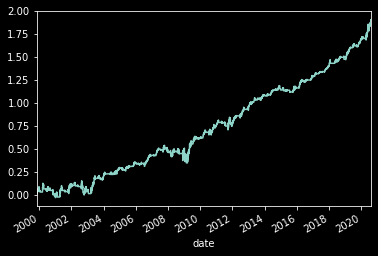

In [14]:
#from BOLLINGER.py run the BOLLINGER simulator on the optimal variables
MACDsimulator = MACDSimulator(
    stock_data_df, 
    #from_date="2018-01-01", 
    period=period, 
    span1=span1,
    span2=span2,
    span3=span3
)
MACDsimulator.simulate()

Get All Signals and Combined Signal

In [ ]:
#function to get all trading signals
#return data frame holding trading signals
def get_trading_signals(ema_signal_df,boligner_signals_df,macd_signals_df):
    trading_signals_df=pd.concat([ema_signal_df, bolinger_signal_df,mcad_signal_df],axis=1,    join="inner")
    trading_signals_df['Signal']=trading_signals_df['EMA Signal']+ trading_signals_df['Bolinger Signal']+ trading_signals_df['MACD Signal']
    trading_signals_df['Overall Entry/Exit']=trading_signals_df['Signal'].diff()
    return trading_signals_df